## 1. Setup and Imports

In [1]:
# Standard library
import sys
import time
import warnings
from collections import defaultdict
from pathlib import Path

import contextily as ctx

# Visualization
import matplotlib.pyplot as plt

# Data manipulation
import numpy as np
import pandas as pd
import plotly.graph_objects as go
import seaborn as sns
import xgboost as xgb
from plotly.subplots import make_subplots
from pyproj import Transformer

# Statistics
from scipy.stats import ks_2samp

# Machine learning
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

# Import splitting utilities
sys.path.insert(0, str(Path('/home/delete/nature_plants')))
from src.splitting import (
    ClimateCriticalSplitter,
    ClimatePCASplitter,
    ClimateVariabilitySplitter,
    ClimateXPCASplitter,
    EnhancedCriticalAdversarialSplitter,
    EnhancedCriticalExtremeSplitter,
    EnhancedCriticalHierarchicalSplitter,
    EnhancedCriticalMaturitySplitter,
    EnhancedCriticalYieldSplitter,
    HybridClimateMaturitySplitter,
    HybridHierarchicalSplitter,
    HybridSimilaritySplitter,
    MaturityBalancedSplitter,
    MaturityGroupedSplitter,
    MaturitySpatialSplitter,
    SimpleSplitter,
    SpatialSplitter,
)
from src.visualization import plot_folds_on_map, plot_split_summary

# Configuration
warnings.filterwarnings('ignore')
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
plt.style.use('seaborn-v0_8-whitegrid')
sns.set_palette('husl')
np.random.seed(42)

print("✅ Imports successful")
print(f"XGBoost version: {xgb.__version__}")

✅ Imports successful
XGBoost version: 3.1.1


In [2]:
# Paths
BASE_DIR = Path('/home/delete/nature_plants')
DATA_DIR = BASE_DIR / 'outputs' / 'data'
RESULTS_DIR = BASE_DIR / 'outputs' / 'results'
FIGURES_DIR = BASE_DIR / 'outputs' / 'figures'

# Create output directories
RESULTS_DIR.mkdir(parents=True, exist_ok=True)
FIGURES_DIR.mkdir(parents=True, exist_ok=True)

print(f"Base directory: {BASE_DIR}")
print(f"Data directory: {DATA_DIR}")
print(f"Results directory: {RESULTS_DIR}")
print(f"Figures directory: {FIGURES_DIR}")

Base directory: /home/delete/nature_plants
Data directory: /home/delete/nature_plants/outputs/data
Results directory: /home/delete/nature_plants/outputs/results
Figures directory: /home/delete/nature_plants/outputs/figures


## 2. Load Data and Define Splitting Strategies

In [3]:
# Load curated data
df = pd.read_csv(DATA_DIR / 'curated_data_anonymized.csv')

print("=== Dataset Overview ===")
print(f"Shape: {df.shape}")
print(f"Trials: {df['trial_anon'].nunique()}")
print(f"Cultivars: {df['cultivar_anon'].nunique()}")
print("\nYield statistics:")
print(df['yield'].describe())

# Display feature columns
# print(f"\nColumns: {list(df.columns)}")

=== Dataset Overview ===
Shape: (4210, 2241)
Trials: 507
Cultivars: 43

Yield statistics:
count    4210.000000
mean       90.363832
std        18.392336
min        20.447800
25%        79.782775
50%        92.839350
75%       103.030025
max       149.400600
Name: yield, dtype: float64


In [4]:
# Define features and target
# Exclude non-feature columns
exclude_cols = [
    'yield',  # target
    'trial_anon', 'cultivar_anon', 'location_anon',  # identifiers
    'year',  # temporal identifier (might want to keep this as feature)
    'maturity_proxy'  # derived feature that might not be in all datasets
]

# Get feature columns
feature_cols = [col for col in df.columns if col not in exclude_cols]

print("=== Feature Configuration ===")
print(f"Total features: {len(feature_cols)}")
# print(f"\nFeature columns:")
# for i, col in enumerate(feature_cols, 1):
    # print(f"  {i:2d}. {col}")

# Check for missing values
missing_counts = df[feature_cols].isnull().sum()
if missing_counts.sum() > 0:
    print("\n⚠️  Missing values detected:")
    print(missing_counts[missing_counts > 0])
else:
    print("\n✅ No missing values in features")

=== Feature Configuration ===
Total features: 2236

✅ No missing values in features


In [5]:
# Define all splitting strategies to test
# Now using dynamic splitting with splitter classes instead of loading CSV files

splitting_strategies = {
    # ============================================================================
    # BASELINE STRATEGIES
    # ============================================================================
    'simple': {
        'splitter': SimpleSplitter(
            test_size=0.2,
            n_folds=5,
            random_state=42,
            output_dir=str(DATA_DIR)
        ),
        'name': 'Simple Random',
        'category': 'Baseline',
        'description': 'Simple random trial-based split'
    },
    'spatial': {
        'splitter': SpatialSplitter(
            test_size=0.2,
            n_folds=5,
            random_state=42,
            n_spatial_clusters=4,
            n_yield_bins=6,
            stratify_by_yield=True,
            output_dir=str(DATA_DIR)
        ),
        'name': 'Spatial Stratified',
        'category': 'Spatial',
        'description': 'Spatial clustering + yield stratification'
    },
    
    # ============================================================================
    # CLIMATE-BASED STRATEGIES
    # ============================================================================
    'climate_pca': {
        'splitter': ClimatePCASplitter(
            test_size=0.2,
            n_folds=5,
            random_state=42,
            n_climate_clusters=5,
            n_yield_bins=5,
            stratify_by_yield=True,
            pca_variance_threshold=0.90,
            output_dir=str(DATA_DIR)
        ),
        'name': 'Climate PCA',
        'category': 'Climate-Based',
        'description': 'PCA-based climate clustering + yield stratification'
    },
    'climate_critical': {
        'splitter': ClimateCriticalSplitter(
            test_size=0.2,
            n_folds=5,
            random_state=42,
            n_climate_clusters=5,
            n_yield_bins=5,
            stratify_by_yield=True,
            critical_period_fraction=0.25,
            output_dir=str(DATA_DIR)
        ),
        'name': 'Climate Critical Period',
        'category': 'Climate-Based',
        'description': 'Critical growth period climate clustering + yield'
    },
    'climate_variability': {
        'splitter': ClimateVariabilitySplitter(
            test_size=0.2,
            n_folds=5,
            random_state=42,
            n_climate_clusters=5,
            n_variability_bins=3,
            stratify_by_yield=True,
            n_yield_bins=3,
            output_dir=str(DATA_DIR)
        ),
        'name': 'Climate Variability',
        'category': 'Climate-Based',
        'description': 'Climate clusters + variability stratification + yield'
    },
    # 1) Baseline X-PCA: 90% variance, raw PCs
    'climate_xpca_90_raw': {
        'splitter': ClimateXPCASplitter(
            test_size=0.2,
            n_folds=5,
            random_state=42,
            n_climate_clusters=5,
            n_yield_bins=5,
            stratify_by_yield=True,
            pca_variance_threshold=0.90,
            pca_n_components=None,
            component_scaling="none",
            output_dir=str(DATA_DIR)
        ),
        'name': 'Climate X-PCA (90% var, raw)',
        'category': 'Climate-Based',
        'description': 'Extended PCA climate clustering (90% variance, raw PCs) + yield stratification'
    },

    # 2) More variance + more clusters
    'climate_xpca_95_raw_k8': {
        'splitter': ClimateXPCASplitter(
            test_size=0.2,
            n_folds=5,
            random_state=42,
            n_climate_clusters=8,          # more climate regimes
            n_yield_bins=5,
            stratify_by_yield=True,
            pca_variance_threshold=0.95,   # keep more PCs
            pca_n_components=None,
            component_scaling="none",
            output_dir=str(DATA_DIR)
        ),
        'name': 'Climate X-PCA (95% var, 8 clusters)',
        'category': 'Climate-Based',
        'description': 'Extended PCA climate clustering (95% variance, 8 climate clusters) + yield stratification'
    },

    # 3) Whitened PCs, 99% variance
    'climate_xpca_whiten_99': {
        'splitter': ClimateXPCASplitter(
            test_size=0.2,
            n_folds=5,
            random_state=42,
            n_climate_clusters=5,
            n_yield_bins=5,
            stratify_by_yield=True,
            pca_variance_threshold=0.99,   # as many PCs as needed for 99% var
            pca_n_components=None,
            component_scaling="whiten",    # all PCs have unit variance for clustering
            output_dir=str(DATA_DIR)
        ),
        'name': 'Climate X-PCA (whitened, 99% var)',
        'category': 'Climate-Based',
        'description': 'Whitened PCA climate clustering (99% variance, equalised PCs) + yield stratification'
    },

    # 4) Fixed 20 PCs with variance-power weighting (emphasise lower-variance PCs)
    'climate_xpca_20pc_varpow': {
        'splitter': ClimateXPCASplitter(
            test_size=0.2,
            n_folds=5,
            random_state=42,
            n_climate_clusters=5,
            n_yield_bins=5,
            stratify_by_yield=True,
            pca_variance_threshold=None,
            pca_n_components=20,           # fixed embedding dimension
            component_scaling="var_power", # λ_i ** component_power
            component_power=-0.5,          # slightly upweight lower-variance PCs
            output_dir=str(DATA_DIR)
        ),
        'name': 'Climate X-PCA (20 PCs, λ^-0.5)',
        'category': 'Climate-Based',
        'description': 'PCA climate clustering with 20 PCs and variance-power weighting (λ^-0.5) + yield stratification'
    },
    # ============================================================================
    # MATURITY-BASED STRATEGIES
    # ============================================================================
    'maturity_balanced': {
        'splitter': MaturityBalancedSplitter(
            test_size=0.2,
            n_folds=5,
            random_state=42,
            n_maturity_bins=3,
            n_yield_bins=5,
            stratify_by_yield=True,
            maturity_feature='TT_heading',
            output_dir=str(DATA_DIR)
        ),
        'name': 'Maturity Balanced',
        'category': 'Maturity-Based',
        'description': 'Balanced maturity groups + yield stratification'
    },
    'maturity_grouped': {
        'splitter': MaturityGroupedSplitter(
            test_size=0.2,
            n_folds=5,
            random_state=42,
            n_maturity_bins=3,
            n_yield_bins=3,
            maturity_feature='TT_heading',
            min_group_size=10,
            output_dir=str(DATA_DIR)
        ),
        'name': 'Maturity Grouped',
        'category': 'Maturity-Based',
        'description': 'Homogeneous maturity groups (within-group split)'
    },
    'maturity_spatial': {
        'splitter': MaturitySpatialSplitter(
            test_size=0.2,
            n_folds=5,
            random_state=42,
            n_maturity_bins=3,
            n_spatial_clusters=4,
            stratify_by_yield=True,
            n_yield_bins=5,
            maturity_feature='TT_heading',
            output_dir=str(DATA_DIR)
        ),
        'name': 'Maturity × Spatial',
        'category': 'Maturity-Based',
        'description': 'Maturity groups + spatial clusters + yield'
    },
    
    # ============================================================================
    # HYBRID STRATEGIES
    # ============================================================================
    'hybrid_climate_maturity': {
        'splitter': HybridClimateMaturitySplitter(
            test_size=0.2,
            n_folds=5,
            random_state=42,
            n_climate_clusters=5,
            n_maturity_bins=3,
            stratify_by_yield=True,
            n_yield_bins=3,
            maturity_feature='TT_heading',
            output_dir=str(DATA_DIR)
        ),
        'name': 'Hybrid Climate+Maturity',
        'category': 'Hybrid',
        'description': 'Climate clusters + maturity groups + yield'
    },
    'hybrid_hierarchical': {
        'splitter': HybridHierarchicalSplitter(
            test_size=0.2,
            n_folds=5,
            random_state=42,
            n_climate_clusters=5,
            n_yield_bins=3,
            maturity_feature='TT_heading',
            output_dir=str(DATA_DIR)
        ),
        'name': 'Hybrid Hierarchical',
        'category': 'Hybrid',
        'description': 'Two-level: climate then maturity stratification'
    },
    'hybrid_similarity': {
        'splitter': HybridSimilaritySplitter(
            test_size=0.2,
            n_folds=5,
            random_state=42,
            n_similarity_clusters=8,
            n_yield_bins=3,
            climate_weight=0.4,
            maturity_weight=0.3,
            spatial_weight=0.2,
            yield_weight=0.1,
            maturity_feature='TT_heading',
            output_dir=str(DATA_DIR)
        ),
        'name': 'Hybrid Similarity',
        'category': 'Hybrid',
        'description': 'Weighted similarity: climate+maturity+spatial+yield'
    },
    
    # ============================================================================
    # ENHANCED CRITICAL STRATEGIES
    # ============================================================================
    'enhanced_critical_yield': {
        'splitter': EnhancedCriticalYieldSplitter(
            test_size=0.2,
            n_folds=5,
            random_state=42,
            n_climate_clusters=5,
            n_yield_bins=10,
            critical_period_fraction=0.25,
            adaptive_yield_bins=True,
            output_dir=str(DATA_DIR)
        ),
        'name': 'Enhanced Critical+Yield',
        'category': 'Enhanced Critical',
        'description': 'Critical period + aggressive yield stratification (10 bins)'
    },
    'enhanced_critical_maturity': {
        'splitter': EnhancedCriticalMaturitySplitter(
            test_size=0.2,
            n_folds=5,
            random_state=42,
            n_climate_clusters=5,
            n_maturity_bins=4,
            n_yield_bins=5,
            critical_period_fraction=0.25,
            maturity_feature='TT_heading',
            output_dir=str(DATA_DIR)
        ),
        'name': 'Enhanced Critical+Maturity',
        'category': 'Enhanced Critical',
        'description': 'Triple stratification: climate+maturity+yield'
    },
    'enhanced_extreme_weather': {
        'splitter': EnhancedCriticalExtremeSplitter(
            test_size=0.2,
            n_folds=5,
            random_state=42,
            n_stress_clusters=6,
            n_yield_bins=5,
            critical_period_fraction=0.25,
            output_dir=str(DATA_DIR)
        ),
        'name': 'Enhanced Extreme Weather',
        'category': 'Enhanced Critical',
        'description': 'Extreme weather signatures (heat/cold/water stress)'
    },
    'enhanced_hierarchical': {
        'splitter': EnhancedCriticalHierarchicalSplitter(
            test_size=0.2,
            n_folds=5,
            random_state=42,
            n_coarse_clusters=3,
            n_fine_clusters=12,
            n_yield_bins=5,
            critical_period_fraction=0.25,
            output_dir=str(DATA_DIR)
        ),
        'name': 'Enhanced Hierarchical',
        'category': 'Enhanced Critical',
        'description': 'Two-stage clustering: coarse zones + fine clusters'
    },
    'enhanced_adversarial': {
        'splitter': EnhancedCriticalAdversarialSplitter(
            test_size=0.2,
            n_folds=5,
            random_state=42,
            adversarial_strength=0.3,
            n_yield_bins=5,
            critical_period_fraction=0.25,
            output_dir=str(DATA_DIR)
        ),
        'name': 'Enhanced Adversarial',
        'category': 'Enhanced Critical',
        'description': 'Adversarial validation (challenging test sets)'
    },
}

print("=" * 80)
print("=== AVAILABLE SPLITTING STRATEGIES ===")
print("=" * 80)
print(f"\nTotal strategies: {len(splitting_strategies)}")

# Group by category
by_category = defaultdict(list)
for key, info in splitting_strategies.items():
    by_category[info['category']].append((key, info))

for category in ['Baseline', 'Spatial', 'Climate-Based', 'Maturity-Based', 'Hybrid', 'Enhanced Critical']:
    if category not in by_category:
        continue
    print(f"\n{category}:")
    for _key, info in by_category[category]:
        print(f"  • {info['name']}")
        print(f"    {info['description']}")
        config = info['splitter'].get_stratification_info()
        if 'stratify_by' in config and config['stratify_by']:
            print(f"    Stratify: {', '.join(config['stratify_by'])}")

print("\n" + "="*80)
print("NOTE: Strategies will be generated dynamically during training.")
print("Fold assignments will be saved to:", DATA_DIR)
print("="*80)

=== AVAILABLE SPLITTING STRATEGIES ===

Total strategies: 20

Baseline:
  • Simple Random
    Simple random trial-based split

Spatial:
  • Spatial Stratified
    Spatial clustering + yield stratification
    Stratify: spatial_cluster, yield_bin

Climate-Based:
  • Climate PCA
    PCA-based climate clustering + yield stratification
    Stratify: climate_cluster, yield_bin
  • Climate Critical Period
    Critical growth period climate clustering + yield
    Stratify: critical_climate_cluster, yield_bin
  • Climate Variability
    Climate clusters + variability stratification + yield
    Stratify: climate_cluster, variability_bin, yield_bin
  • Climate X-PCA (90% var, raw)
    Extended PCA climate clustering (90% variance, raw PCs) + yield stratification
    Stratify: climate_cluster, yield_bin
  • Climate X-PCA (95% var, 8 clusters)
    Extended PCA climate clustering (95% variance, 8 climate clusters) + yield stratification
    Stratify: climate_cluster, yield_bin
  • Climate X-PCA (wh

## 3. Define Baseline XGBoost Model

In [6]:
# Baseline XGBoost configuration
# Using reasonable defaults without extensive tuning
BASELINE_PARAMS = {
    'objective': 'reg:squarederror',
    'eval_metric': 'rmse',
    'max_depth': 5,
    'learning_rate': 0.1,
    'n_estimators': 50,
    'subsample': 0.8,
    'colsample_bytree': 0.8,
    'min_child_weight': 3,
    'gamma': 0,
    'reg_alpha': 0,
    'reg_lambda': 1,
    'random_state': 42,
    'n_jobs': 12,
    'verbosity': 0,
    'device': 'cuda'
}

print("=== Baseline XGBoost Configuration ===")
for param, value in BASELINE_PARAMS.items():
    print(f"  {param:20s}: {value}")

=== Baseline XGBoost Configuration ===
  objective           : reg:squarederror
  eval_metric         : rmse
  max_depth           : 5
  learning_rate       : 0.1
  n_estimators        : 50
  subsample           : 0.8
  colsample_bytree    : 0.8
  min_child_weight    : 3
  gamma               : 0
  reg_alpha           : 0
  reg_lambda          : 1
  random_state        : 42
  n_jobs              : 12
  verbosity           : 0
  device              : cuda


In [7]:
def train_and_evaluate_fold(X_train, y_train, X_val, y_val, fold_idx, strategy_name):
    """
    Train XGBoost model on a single fold and evaluate.
    
    Returns:
        dict: Performance metrics and predictions
    """
    # Train model
    model = xgb.XGBRegressor(**BASELINE_PARAMS)
    
    start_time = time.time()
    model.fit(
        X_train, y_train,
        eval_set=[(X_val, y_val)],
        verbose=False
    )
    train_time = time.time() - start_time
    
    # Predictions
    y_train_pred = model.predict(X_train)
    y_val_pred = model.predict(X_val)
    
    # Metrics
    train_rmse = np.sqrt(mean_squared_error(y_train, y_train_pred))
    train_mae = mean_absolute_error(y_train, y_train_pred)
    train_r2 = r2_score(y_train, y_train_pred)
    
    val_rmse = np.sqrt(mean_squared_error(y_val, y_val_pred))
    val_mae = mean_absolute_error(y_val, y_val_pred)
    val_r2 = r2_score(y_val, y_val_pred)
    
    return {
        'fold': fold_idx,
        'strategy': strategy_name,
        'n_train': len(y_train),
        'n_val': len(y_val),
        'train_rmse': train_rmse,
        'train_mae': train_mae,
        'train_r2': train_r2,
        'val_rmse': val_rmse,
        'val_mae': val_mae,
        'val_r2': val_r2,
        'train_time': train_time,
        'y_val_true': y_val.values,
        'y_val_pred': y_val_pred,
        'model': model
    }

print("✅ Training function defined")

✅ Training function defined


## 4. Train Models on All Splitting Strategies

In [8]:
# Store all results
all_results = []
test_results = []
trial_stats_cache = {}
fold_df_cache = {}  # Cache fold assignments used during training

print("=" * 80)
print("TRAINING BASELINE XGBOOST ON ALL SPLITTING STRATEGIES")
print("=" * 80)

for strategy_key, strategy_info in splitting_strategies.items():
    print(f"\n{'=' * 80}")
    print(f"Strategy: {strategy_info['name']}")
    print(f"Category: {strategy_info['category']}")
    print(f"Description: {strategy_info['description']}")
    print(f"{'=' * 80}")
    
    # Generate splits using the splitter
    splitter = strategy_info['splitter']
    print("\nGenerating splits with configuration:")
    config = splitter.get_stratification_info()
    for key, value in config.items():
        print(f"  {key}: {value}")
    print()
    
    # Perform split
    train_trials, test_trials, fold_df = splitter.split(df)
    
    # Cache fold assignments for visualization
    fold_df_cache[strategy_key] = fold_df.copy()
    
    # Cache trial stats for visualization later
    from src.utils import calculate_trial_stats
    if strategy_key not in trial_stats_cache:
        trial_stats_cache[strategy_key] = calculate_trial_stats(df)
        # Add spatial clusters if this is a spatial splitter
        if hasattr(splitter, 'n_spatial_clusters'):
            from sklearn.cluster import KMeans
            kmeans = KMeans(n_clusters=splitter.n_spatial_clusters,
                          random_state=splitter.random_state, n_init=10)
            trial_stats_cache[strategy_key]['spatial_cluster'] = kmeans.fit_predict(
                trial_stats_cache[strategy_key][['latitude', 'longitude']]
            )
    
    # Get test set
    test_mask = df['trial_anon'].isin(test_trials)
    X_test = df[test_mask][feature_cols]
    y_test = df[test_mask]['yield']
    
    print(f"\nTest set: {len(y_test)} samples from {len(test_trials)} trials")
    
    # Visualize folds on map
    print("\nGenerating fold visualization map...")
    fig = plot_folds_on_map(
        df, fold_df, trial_stats_cache[strategy_key],
        figsize=(15, 10),
        add_wiggle=True,
        save_path=str(FIGURES_DIR / f'folds_map_{strategy_key}.png')
    )
    plt.close(fig)
    
    # Generate split summary plots
    print("Generating split summary plots...")
    fig = plot_split_summary(
        df, train_trials, test_trials, trial_stats_cache[strategy_key],
        save_path=str(FIGURES_DIR / f'split_summary_{strategy_key}.png')
    )
    plt.close(fig)
    
    # Train on each fold
    n_folds = fold_df[fold_df['split'] != 'test']['fold'].max() + 1
    fold_models = []
    
    for fold_idx in range(n_folds):
        print(f"\n  Fold {fold_idx + 1}/{n_folds}...", end=" ")
        
        # Get train and validation trials for this fold
        train_trials_fold = fold_df[
            (fold_df['fold'] == fold_idx) & (fold_df['split'] == 'train')
        ]['trial_anon'].values
        
        val_trials_fold = fold_df[
            (fold_df['fold'] == fold_idx) & (fold_df['split'] == 'val')
        ]['trial_anon'].values
        
        # Get data masks
        train_mask_fold = df['trial_anon'].isin(train_trials_fold)
        val_mask_fold = df['trial_anon'].isin(val_trials_fold)
        
        # Prepare data
        X_train_fold = df[train_mask_fold][feature_cols]
        y_train_fold = df[train_mask_fold]['yield']
        X_val_fold = df[val_mask_fold][feature_cols]
        y_val_fold = df[val_mask_fold]['yield']
        
        # Train and evaluate
        fold_result = train_and_evaluate_fold(
            X_train_fold, y_train_fold,
            X_val_fold, y_val_fold,
            fold_idx,
            strategy_info['name']
        )
        
        fold_result['strategy_key'] = strategy_key
        fold_result['category'] = strategy_info['category']
        
        all_results.append(fold_result)
        fold_models.append(fold_result['model'])
        
        print(f"Val RMSE: {fold_result['val_rmse']:.2f} | "
              f"Val R²: {fold_result['val_r2']:.3f} | "
              f"Time: {fold_result['train_time']:.1f}s")
    
    # Evaluate on test set using all fold models (ensemble)
    print(f"\n  Evaluating on test set (ensemble of {n_folds} models)...", end=" ")
    
    test_predictions = np.mean([model.predict(X_test) for model in fold_models], axis=0)
    
    test_rmse = np.sqrt(mean_squared_error(y_test, test_predictions))
    test_mae = mean_absolute_error(y_test, test_predictions)
    test_r2 = r2_score(y_test, test_predictions)
    
    print(f"Test RMSE: {test_rmse:.2f} | Test R²: {test_r2:.3f}")
    
    test_results.append({
        'strategy_key': strategy_key,
        'strategy': strategy_info['name'],
        'category': strategy_info['category'],
        'test_rmse': test_rmse,
        'test_mae': test_mae,
        'test_r2': test_r2,
        'n_test': len(y_test),
        'y_test_true': y_test.values,
        'y_test_pred': test_predictions
    })
    
    # Summary statistics for this strategy
    strategy_folds = [r for r in all_results if r['strategy_key'] == strategy_key]
    val_rmses = [r['val_rmse'] for r in strategy_folds]
    
    print(f"\n  📊 Summary for {strategy_info['name']}:")
    print(f"     CV RMSE: {np.mean(val_rmses):.2f} ± {np.std(val_rmses):.2f}")
    print(f"     Test RMSE: {test_rmse:.2f}")
    print(f"     Gap (CV→Test): {test_rmse - np.mean(val_rmses):+.2f}")

print(f"{'=' * 80}")
print("✅ TRAINING COMPLETE FOR ALL STRATEGIES")

TRAINING BASELINE XGBOOST ON ALL SPLITTING STRATEGIES

Strategy: Simple Random
Category: Baseline
Description: Simple random trial-based split

Generating splits with configuration:
  cv_method: simple
  stratify_by: []
  group_by: None
  n_folds: 5
  test_size: 0.2
  random_state: 42

=== Simple Random Split ===

=== Split Summary ===
Total trials: 507
Train trials: 405 (79.9%)
Test trials: 102 (20.1%)

=== Sample Distribution ===
Train samples: 3,421 (81.3%)
Test samples: 789 (18.7%)

=== Yield Distribution Comparison ===
Metric            Train       Test       Diff
--------------------------------------------
Mean              90.05      91.74       1.69
Std               18.84      16.27       2.57
Min               20.45      33.53      13.08
Max              149.40     128.47      20.93
Median            92.50      93.67       1.17
Q25               78.95      82.81       3.86
Q75              103.01     103.19       0.17
Saved fold assignments to /home/delete/nature_plants/outp

## 5. Analyze and Compare Results

In [9]:
# Create results dataframes
df_cv_results = pd.DataFrame([
    {k: v for k, v in r.items() if k not in ['y_val_true', 'y_val_pred', 'model']}
    for r in all_results
])

df_test_results = pd.DataFrame([
    {k: v for k, v in r.items() if k not in ['y_test_true', 'y_test_pred']}
    for r in test_results
])

print("=== Cross-Validation Results ===")
print(df_cv_results.head())
print(f"\nTotal CV runs: {len(df_cv_results)}")

print("\n=== Test Set Results ===")
print(df_test_results)
print(f"\nTotal test evaluations: {len(df_test_results)}")

=== Cross-Validation Results ===
   fold       strategy  n_train  n_val  train_rmse  train_mae  train_r2  \
0     0  Simple Random     2727    694    5.194864   3.899575  0.927031   
1     1  Simple Random     2720    701    5.416186   4.073820  0.919200   
2     2  Simple Random     2765    656    5.318001   3.971210  0.918212   
3     3  Simple Random     2736    685    5.031062   3.824109  0.928305   
4     4  Simple Random     2736    685    5.247596   3.988467  0.919361   

    val_rmse    val_mae    val_r2  train_time strategy_key  category  
0  13.558791  10.196932  0.377496    0.960240       simple  Baseline  
1  14.705444  11.261301  0.326966    0.610539       simple  Baseline  
2  15.032557  11.543011  0.415976    0.624204       simple  Baseline  
3  16.394546  12.698429  0.248555    0.679476       simple  Baseline  
4  14.845802  11.042806  0.456788    0.640647       simple  Baseline  

Total CV runs: 100

=== Test Set Results ===
                  strategy_key              

In [10]:
# Calculate summary statistics per strategy
cv_summary = df_cv_results.groupby(['strategy_key', 'strategy', 'category']).agg({
    'val_rmse': ['mean', 'std', 'min', 'max'],
    'val_mae': ['mean', 'std'],
    'val_r2': ['mean', 'std'],
    'train_rmse': ['mean', 'std'],
    'train_time': 'sum'
}).reset_index()

# Flatten column names
cv_summary.columns = ['_'.join(col).strip('_') for col in cv_summary.columns.values]

# Merge with test results
comparison_df = cv_summary.merge(
    df_test_results[['strategy_key', 'test_rmse', 'test_mae', 'test_r2']],
    on='strategy_key'
)

# Calculate CV coefficient of variation
comparison_df['cv_rmse_cv'] = comparison_df['val_rmse_std'] / comparison_df['val_rmse_mean']

# Calculate generalization gap
comparison_df['generalization_gap'] = comparison_df['test_rmse'] - comparison_df['val_rmse_mean']

# Calculate overfitting (train-val gap)
comparison_df['overfitting'] = comparison_df['val_rmse_mean'] - comparison_df['train_rmse_mean']

# Sort by test RMSE (lower is better)
comparison_df = comparison_df.sort_values('test_rmse')

print("=" * 100)
print("COMPREHENSIVE STRATEGY COMPARISON")
print("=" * 100)
print("\nRanked by Test RMSE (lower is better):")
print("\n" + comparison_df[[
    'strategy', 'category',
    'val_rmse_mean', 'val_rmse_std', 'cv_rmse_cv',
    'test_rmse', 'generalization_gap',
    'overfitting'
]].to_string(index=False))

# Save results
comparison_df.to_csv(RESULTS_DIR / 'splitting_strategy_xgboost_comparison.csv', index=False)
print(f"\n💾 Results saved to: {RESULTS_DIR / 'splitting_strategy_xgboost_comparison.csv'}")

COMPREHENSIVE STRATEGY COMPARISON

Ranked by Test RMSE (lower is better):

                           strategy          category  val_rmse_mean  val_rmse_std  cv_rmse_cv  test_rmse  generalization_gap  overfitting
                        Climate PCA     Climate-Based      15.205651      1.214712    0.079886  11.354292           -3.851359    10.056459
       Climate X-PCA (90% var, raw)     Climate-Based      15.205651      1.214712    0.079886  11.354292           -3.851359    10.056459
     Climate X-PCA (20 PCs, λ^-0.5)     Climate-Based      15.793261      1.475634    0.093434  11.398247           -4.395014    10.621811
         Enhanced Critical+Maturity Enhanced Critical      15.202393      0.971159    0.063882  11.403379           -3.799013    10.081320
Climate X-PCA (95% var, 8 clusters)     Climate-Based      15.790503      1.480786    0.093777  11.512090           -4.278413    10.658339
           Enhanced Extreme Weather Enhanced Critical      15.621803      1.222933    0.078

In [11]:
# Identify best strategies
best_test_rmse = comparison_df.iloc[0]
best_cv_stability = comparison_df.loc[comparison_df['cv_rmse_cv'].idxmin()]
best_generalization = comparison_df.loc[comparison_df['generalization_gap'].abs().idxmin()]

print("=" * 100)
print("🏆 BEST STRATEGIES BY CRITERION")
print("=" * 100)

print("\n1️⃣  BEST TEST PERFORMANCE (lowest RMSE):")
print(f"   Strategy: {best_test_rmse['strategy']}")
print(f"   Category: {best_test_rmse['category']}")
print(f"   Test RMSE: {best_test_rmse['test_rmse']:.3f}")
print(f"   CV RMSE: {best_test_rmse['val_rmse_mean']:.3f} ± {best_test_rmse['val_rmse_std']:.3f}")
print(f"   Test R²: {best_test_rmse['test_r2']:.3f}")

print("\n2️⃣  MOST STABLE CROSS-VALIDATION (lowest CV):")
print(f"   Strategy: {best_cv_stability['strategy']}")
print(f"   Category: {best_cv_stability['category']}")
print(f"   CV Coefficient: {best_cv_stability['cv_rmse_cv']:.4f}")
print(f"   CV RMSE: {best_cv_stability['val_rmse_mean']:.3f} ± {best_cv_stability['val_rmse_std']:.3f}")
print(f"   Test RMSE: {best_cv_stability['test_rmse']:.3f}")

print("\n3️⃣  BEST GENERALIZATION (smallest CV-test gap):")
print(f"   Strategy: {best_generalization['strategy']}")
print(f"   Category: {best_generalization['category']}")
print(f"   Generalization Gap: {best_generalization['generalization_gap']:+.3f}")
print(f"   CV RMSE: {best_generalization['val_rmse_mean']:.3f}")
print(f"   Test RMSE: {best_generalization['test_rmse']:.3f}")

print(f"\n{'=' * 100}")

🏆 BEST STRATEGIES BY CRITERION

1️⃣  BEST TEST PERFORMANCE (lowest RMSE):
   Strategy: Climate PCA
   Category: Climate-Based
   Test RMSE: 11.354
   CV RMSE: 15.206 ± 1.215
   Test R²: 0.551

2️⃣  MOST STABLE CROSS-VALIDATION (lowest CV):
   Strategy: Hybrid Climate+Maturity
   Category: Hybrid
   CV Coefficient: 0.0375
   CV RMSE: 15.118 ± 0.566
   Test RMSE: 11.854

3️⃣  BEST GENERALIZATION (smallest CV-test gap):
   Strategy: Hybrid Similarity
   Category: Hybrid
   Generalization Gap: -0.254
   CV RMSE: 15.207
   Test RMSE: 14.953



## 6. Visualizations

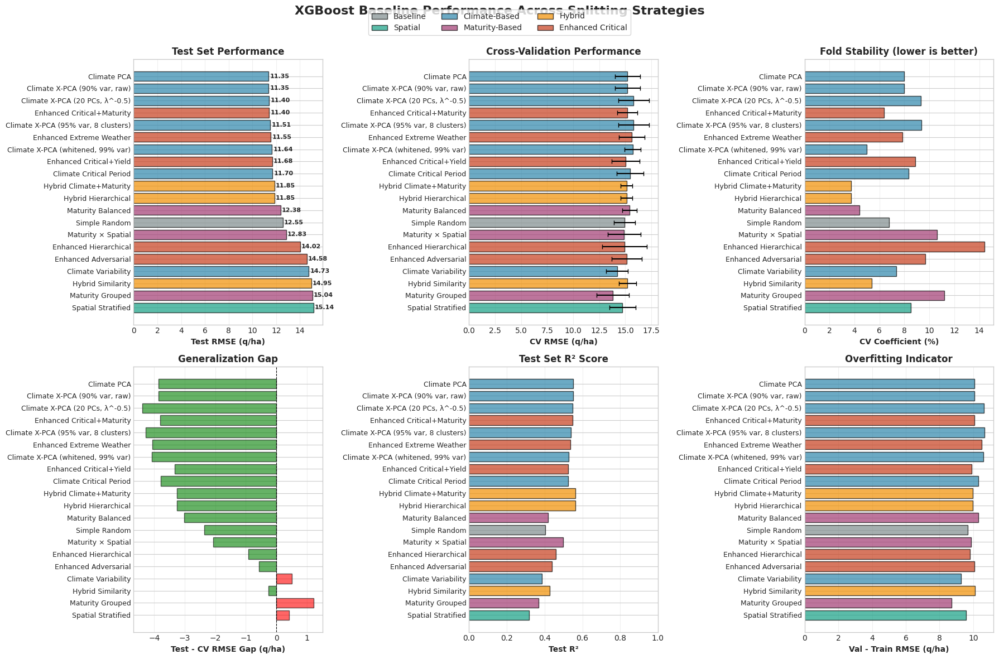


💾 Figure saved to: /home/delete/nature_plants/outputs/figures/splitting_strategy_comparison_comprehensive.png


In [12]:
# Create comprehensive comparison plot
fig, axes = plt.subplots(2, 3, figsize=(18, 12))
fig.suptitle('XGBoost Baseline Performance Across Splitting Strategies', fontsize=16, fontweight='bold')

# Define colors by category
category_colors = {
    'Baseline': '#7F8C8D',
    'Spatial': '#16A085',
    'Climate-Based': '#2E86AB',
    'Maturity-Based': '#A23B72',
    'Hybrid': '#F18F01',
    'Enhanced Critical': '#C73E1D'
}

colors = [category_colors[cat] for cat in comparison_df['category']]

# 1. Test RMSE comparison
ax = axes[0, 0]
bars = ax.barh(range(len(comparison_df)), comparison_df['test_rmse'], color=colors, alpha=0.7, edgecolor='black')
ax.set_yticks(range(len(comparison_df)))
ax.set_yticklabels(comparison_df['strategy'], fontsize=9)
ax.set_xlabel('Test RMSE (q/ha)', fontweight='bold')
ax.set_title('Test Set Performance', fontweight='bold')
ax.invert_yaxis()
ax.grid(axis='x', alpha=0.3)
# Add values
for i, (_idx, row) in enumerate(comparison_df.iterrows()):
    ax.text(row['test_rmse'] + 0.1, i, f"{row['test_rmse']:.2f}",
            va='center', fontsize=8, fontweight='bold')

# 2. CV RMSE with error bars
ax = axes[0, 1]
ax.barh(range(len(comparison_df)), comparison_df['val_rmse_mean'],
        xerr=comparison_df['val_rmse_std'], color=colors, alpha=0.7,
        edgecolor='black', capsize=3)
ax.set_yticks(range(len(comparison_df)))
ax.set_yticklabels(comparison_df['strategy'], fontsize=9)
ax.set_xlabel('CV RMSE (q/ha)', fontweight='bold')
ax.set_title('Cross-Validation Performance', fontweight='bold')
ax.invert_yaxis()
ax.grid(axis='x', alpha=0.3)

# 3. CV Stability (coefficient of variation)
ax = axes[0, 2]
ax.barh(range(len(comparison_df)), comparison_df['cv_rmse_cv'] * 100,
        color=colors, alpha=0.7, edgecolor='black')
ax.set_yticks(range(len(comparison_df)))
ax.set_yticklabels(comparison_df['strategy'], fontsize=9)
ax.set_xlabel('CV Coefficient (%)', fontweight='bold')
ax.set_title('Fold Stability (lower is better)', fontweight='bold')
ax.invert_yaxis()
ax.grid(axis='x', alpha=0.3)

# 4. Generalization Gap
ax = axes[1, 0]
gap_colors = ['green' if x < 0 else 'red' for x in comparison_df['generalization_gap']]
ax.barh(range(len(comparison_df)), comparison_df['generalization_gap'],
        color=gap_colors, alpha=0.6, edgecolor='black')
ax.axvline(0, color='black', linewidth=0.8, linestyle='--')
ax.set_yticks(range(len(comparison_df)))
ax.set_yticklabels(comparison_df['strategy'], fontsize=9)
ax.set_xlabel('Test - CV RMSE Gap (q/ha)', fontweight='bold')
ax.set_title('Generalization Gap', fontweight='bold')
ax.invert_yaxis()
ax.grid(axis='x', alpha=0.3)

# 5. Test R² comparison
ax = axes[1, 1]
ax.barh(range(len(comparison_df)), comparison_df['test_r2'],
        color=colors, alpha=0.7, edgecolor='black')
ax.set_yticks(range(len(comparison_df)))
ax.set_yticklabels(comparison_df['strategy'], fontsize=9)
ax.set_xlabel('Test R²', fontweight='bold')
ax.set_title('Test Set R² Score', fontweight='bold')
ax.invert_yaxis()
ax.grid(axis='x', alpha=0.3)
ax.set_xlim([0, 1])

# 6. Overfitting analysis
ax = axes[1, 2]
ax.barh(range(len(comparison_df)), comparison_df['overfitting'],
        color=colors, alpha=0.7, edgecolor='black')
ax.set_yticks(range(len(comparison_df)))
ax.set_yticklabels(comparison_df['strategy'], fontsize=9)
ax.set_xlabel('Val - Train RMSE (q/ha)', fontweight='bold')
ax.set_title('Overfitting Indicator', fontweight='bold')
ax.invert_yaxis()
ax.grid(axis='x', alpha=0.3)

# Add legend
from matplotlib.patches import Patch

legend_elements = [Patch(facecolor=color, label=cat, alpha=0.7, edgecolor='black')
                   for cat, color in category_colors.items()]
fig.legend(handles=legend_elements, loc='upper center', ncol=3,
          bbox_to_anchor=(0.5, 0.98), fontsize=10, frameon=True)

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.savefig(FIGURES_DIR / 'splitting_strategy_comparison_comprehensive.png',
            dpi=300, bbox_inches='tight')
plt.show()

print(f"\n💾 Figure saved to: {FIGURES_DIR / 'splitting_strategy_comparison_comprehensive.png'}")

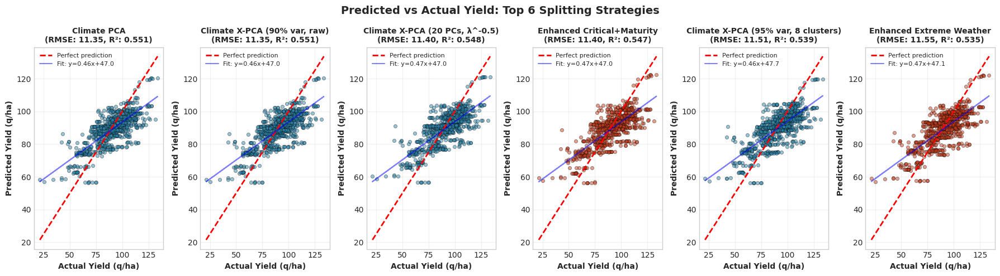


💾 Figure saved to: /home/delete/nature_plants/outputs/figures/splitting_strategy_predictions_top6.png


In [13]:
# Plot predicted vs actual for best 3 strategies
k = 6
top_k_strategies = comparison_df.head(k)

fig, axes = plt.subplots(1, k, figsize=(18, 5))
fig.suptitle(f'Predicted vs Actual Yield: Top {k} Splitting Strategies',
             fontsize=14, fontweight='bold')

for idx, (_, row) in enumerate(top_k_strategies.iterrows()):
    ax = axes[idx]
    
    # Get test predictions for this strategy
    test_result = [r for r in test_results if r['strategy_key'] == row['strategy_key']][0]
    y_true = test_result['y_test_true']
    y_pred = test_result['y_test_pred']
    
    # Scatter plot
    ax.scatter(y_true, y_pred, alpha=0.5, s=20,
               color=category_colors[row['category']], edgecolor='black', linewidth=0.5)
    
    # Perfect prediction line
    min_val = min(y_true.min(), y_pred.min())
    max_val = max(y_true.max(), y_pred.max())
    ax.plot([min_val, max_val], [min_val, max_val], 'r--', linewidth=2, label='Perfect prediction')
    
    # Labels and metrics
    ax.set_xlabel('Actual Yield (q/ha)', fontweight='bold')
    ax.set_ylabel('Predicted Yield (q/ha)', fontweight='bold')
    ax.set_title(f"{row['strategy']}\n(RMSE: {row['test_rmse']:.2f}, R²: {row['test_r2']:.3f})",
                 fontweight='bold', fontsize=10)
    ax.grid(alpha=0.3)
    ax.legend(loc='upper left', fontsize=8)
    
    # Add regression line
    z = np.polyfit(y_true, y_pred, 1)
    p = np.poly1d(z)
    ax.plot(y_true, p(y_true), 'b-', alpha=0.5, linewidth=1.5, label=f'Fit: y={z[0]:.2f}x+{z[1]:.1f}')
    ax.legend(loc='upper left', fontsize=8)

plt.tight_layout()
plt.savefig(FIGURES_DIR / f'splitting_strategy_predictions_top{k}.png',
            dpi=300, bbox_inches='tight')
plt.show()

print(f"\n💾 Figure saved to: {FIGURES_DIR / f'splitting_strategy_predictions_top{k}.png'}")

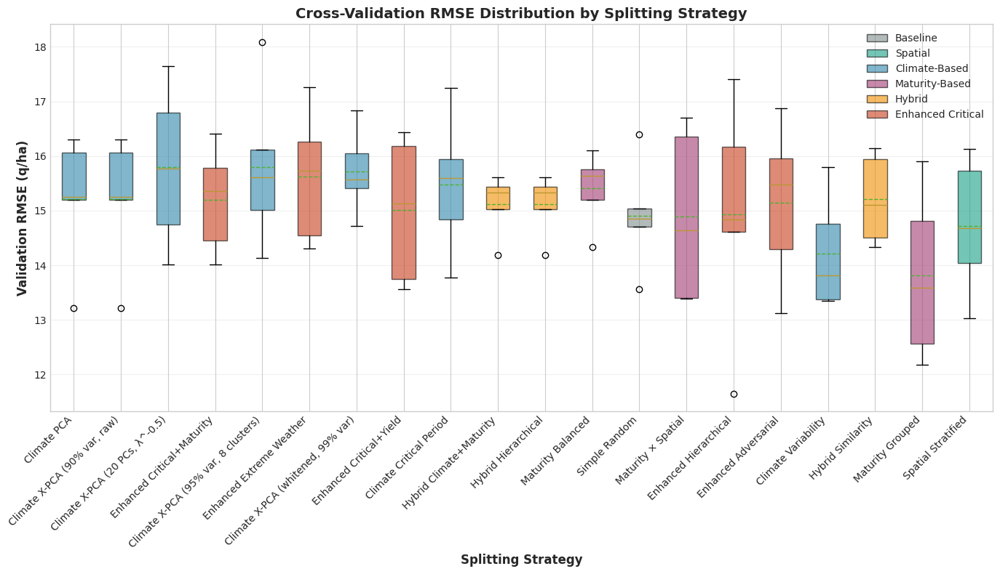


💾 Figure saved to: /home/delete/nature_plants/outputs/figures/splitting_strategy_cv_distribution.png


In [14]:
# Box plot of CV performance by strategy
fig, ax = plt.subplots(figsize=(14, 8))

# Prepare data for box plot
strategies_ordered = comparison_df['strategy'].values
data_by_strategy = []

for strategy in strategies_ordered:
    strategy_data = df_cv_results[df_cv_results['strategy'] == strategy]['val_rmse'].values
    data_by_strategy.append(strategy_data)

bp = ax.boxplot(data_by_strategy, labels=strategies_ordered, patch_artist=True,
                showmeans=True, meanline=True)

# Color boxes by category
for patch, strategy in zip(bp['boxes'], strategies_ordered, strict=False):
    category = comparison_df[comparison_df['strategy'] == strategy]['category'].values[0]
    patch.set_facecolor(category_colors[category])
    patch.set_alpha(0.6)

ax.set_xlabel('Splitting Strategy', fontweight='bold', fontsize=12)
ax.set_ylabel('Validation RMSE (q/ha)', fontweight='bold', fontsize=12)
ax.set_title('Cross-Validation RMSE Distribution by Splitting Strategy',
             fontweight='bold', fontsize=14)
ax.grid(axis='y', alpha=0.3)
plt.xticks(rotation=45, ha='right')

# Add legend
from matplotlib.patches import Patch

legend_elements = [Patch(facecolor=color, label=cat, alpha=0.6, edgecolor='black')
                   for cat, color in category_colors.items()]
ax.legend(handles=legend_elements, loc='upper right', fontsize=10)

plt.tight_layout()
plt.savefig(FIGURES_DIR / 'splitting_strategy_cv_distribution.png',
            dpi=300, bbox_inches='tight')
plt.show()

print(f"\n💾 Figure saved to: {FIGURES_DIR / 'splitting_strategy_cv_distribution.png'}")

## 7. Statistical Comparison

### 7.1. Grid of Contextily Maps: Train/Test/Folds by Strategy

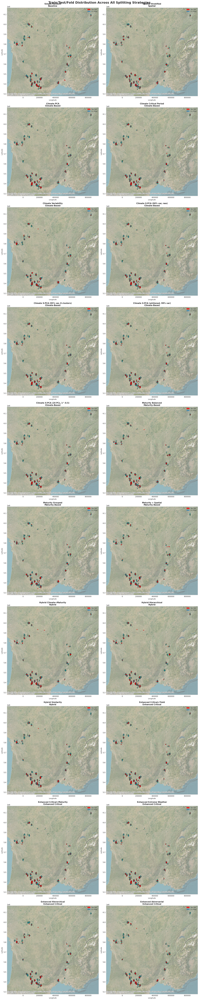


💾 Grid of contextily maps saved to: /home/delete/nature_plants/outputs/figures/splitting_strategy_maps_grid_contextily.png


In [15]:
# Create grid of contextily maps showing train/test/folds for all strategies
import matplotlib.patches as mpatches
from matplotlib.patches import Circle

# Calculate number of rows needed (2 strategies per row)
n_strategies = len(splitting_strategies)
n_cols = 2
n_rows = (n_strategies + n_cols - 1) // n_cols

fig, axes = plt.subplots(n_rows, n_cols, figsize=(16, 8 * n_rows))
if n_rows == 1:
    axes = axes.reshape(1, -1)

fig.suptitle('Train/Test/Fold Distribution Across All Splitting Strategies',
             fontsize=18, fontweight='bold', y=0.995)

# Flatten axes for easier iteration
axes_flat = axes.flatten()

# Get overall coordinate bounds for consistent map extent
all_lats = []
all_lons = []
for trial_stats in trial_stats_cache.values():
    all_lats.extend(trial_stats['latitude'].values)
    all_lons.extend(trial_stats['longitude'].values)

lat_min, lat_max = min(all_lats), max(all_lats)
lon_min, lon_max = min(all_lons), max(all_lons)

# Add padding
lat_padding = (lat_max - lat_min) * 0.1
lon_padding = (lon_max - lon_min) * 0.1

for idx, (strategy_key, strategy_info) in enumerate(splitting_strategies.items()):
    ax = axes_flat[idx]
    
    # Get data for this strategy
    trial_stats = trial_stats_cache[strategy_key]
    
    # Use cached fold assignments from training (not regenerated!)
    fold_df = fold_df_cache[strategy_key]
    
    # Merge fold information with trial stats
    trial_stats_with_folds = trial_stats.merge(
        fold_df[['trial_anon', 'fold', 'split']],
        on='trial_anon',
        how='left'
    )
    
    # Add small random jitter to avoid perfect overlap
    np.random.seed(42)
    jitter_scale = 0.03  # Reduced jitter
    trial_stats_with_folds['lat_jitter'] = (
        trial_stats_with_folds['latitude'] +
        np.random.normal(0, jitter_scale, len(trial_stats_with_folds))
    )
    trial_stats_with_folds['lon_jitter'] = (
        trial_stats_with_folds['longitude'] +
        np.random.normal(0, jitter_scale, len(trial_stats_with_folds))
    )
    
    # Convert to Web Mercator for contextily
    transformer = Transformer.from_crs("EPSG:4326", "EPSG:3857", always_xy=True)
    
    trial_stats_with_folds['x'], trial_stats_with_folds['y'] = transformer.transform(
        trial_stats_with_folds['lon_jitter'].values,
        trial_stats_with_folds['lat_jitter'].values
    )
    
    # Define colors for test set and folds
    test_set = trial_stats_with_folds[trial_stats_with_folds['split'] == 'test']
    train_val_set = trial_stats_with_folds[trial_stats_with_folds['split'] != 'test']
    
    # Plot test set in red with smaller points
    if len(test_set) > 0:
        scatter_test = ax.scatter(
            test_set['x'], test_set['y'],
            s=15,  # Much smaller, fixed size
            c='red',
            alpha=0.8,
            edgecolor='darkred',
            linewidth=0.5,
            label='Test Set',
            zorder=3
        )
    
    # Plot training folds with different colors
    n_folds = train_val_set['fold'].nunique()
    fold_colors = plt.cm.tab10(np.linspace(0, 1, n_folds))
    
    for fold_idx in range(n_folds):
        fold_data = train_val_set[train_val_set['fold'] == fold_idx]
        if len(fold_data) > 0:
            ax.scatter(
                fold_data['x'], fold_data['y'],
                s=12,  # Smaller, fixed size
                c=[fold_colors[fold_idx]],
                alpha=0.6,
                edgecolor='black',
                linewidth=0.3,
                label=f'Fold {fold_idx}',
                zorder=2
            )
    
    # Add basemap with heightmap/satellite imagery background
    try:
        ctx.add_basemap(ax, source=ctx.providers.Esri.WorldImagery, zoom=6, alpha=0.5)
    except Exception as e:
        # Fallback to OpenTopoMap (topographic/heightmap)
        try:
            ctx.add_basemap(ax, source=ctx.providers.OpenTopoMap, zoom=6, alpha=0.6)
        except Exception:
            print(f"Warning: Could not add basemap for {strategy_key}: {e}")
    
    # Set extent in Web Mercator
    x_min, y_min = transformer.transform(lon_min - lon_padding, lat_min - lat_padding)
    x_max, y_max = transformer.transform(lon_max + lon_padding, lat_max + lat_padding)
    ax.set_xlim(x_min, x_max)
    ax.set_ylim(y_min, y_max)
    
    # Labels and title
    ax.set_title(f"{strategy_info['name']}\n{strategy_info['category']}",
                 fontweight='bold', fontsize=11)
    ax.set_xlabel('Longitude', fontsize=9)
    ax.set_ylabel('Latitude', fontsize=9)
    
    # Legend (only show test + first fold to avoid clutter)
    handles = [
        mpatches.Patch(color='red', label='Test Set', alpha=0.8),
        mpatches.Patch(color=fold_colors[0], label='CV Folds', alpha=0.6)
    ]
    ax.legend(handles=handles, loc='upper right', fontsize=8, framealpha=0.9)
    
    # Grid
    ax.grid(True, alpha=0.3)

# Hide empty subplots if odd number of strategies
for idx in range(len(splitting_strategies), len(axes_flat)):
    axes_flat[idx].axis('off')

plt.tight_layout()
plt.savefig(FIGURES_DIR / 'splitting_strategy_maps_grid_contextily.png',
            dpi=300, bbox_inches='tight')
plt.show()

print(f"\n💾 Grid of contextily maps saved to: {FIGURES_DIR / 'splitting_strategy_maps_grid_contextily.png'}")

### 7.2. Grid of Residual Maps by Strategy

=== Simple Random Split ===

=== Split Summary ===
Total trials: 507
Train trials: 405 (79.9%)
Test trials: 102 (20.1%)

=== Sample Distribution ===
Train samples: 3,421 (81.3%)
Test samples: 789 (18.7%)

=== Yield Distribution Comparison ===
Metric            Train       Test       Diff
--------------------------------------------
Mean              90.05      91.74       1.69
Std               18.84      16.27       2.57
Min               20.45      33.53      13.08
Max              149.40     128.47      20.93
Median            92.50      93.67       1.17
Q25               78.95      82.81       3.86
Q75              103.01     103.19       0.17
Saved fold assignments to /home/delete/nature_plants/outputs/data/folds_simple.csv
Saved metadata to /home/delete/nature_plants/outputs/data/folds_simple.json
=== Spatial Clustering Split (n_clusters=4) ===

=== Trial-Level Statistics ===
Trials: 507
Yield mean range: 35.2 - 141.2
Latitude range: 43.23 - 47.89
Longitude range: -0.93 - 7.49

=

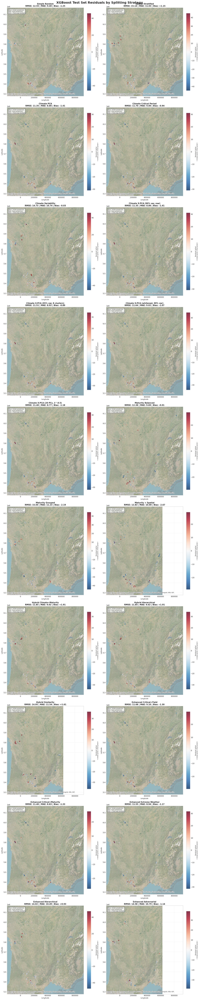


💾 Grid of residual maps saved to: /home/delete/nature_plants/outputs/figures/splitting_strategy_residual_maps_grid.png

✅ Note: RMSE values now match barplots (observation-level, not trial-level)


In [16]:
# Create grid of residual maps for XGBoost test predictions
from matplotlib.colors import TwoSlopeNorm

fig, axes = plt.subplots(n_rows, n_cols, figsize=(16, 8 * n_rows))
if n_rows == 1:
    axes = axes.reshape(1, -1)

fig.suptitle('XGBoost Test Set Residuals by Splitting Strategy',
             fontsize=18, fontweight='bold', y=0.995)

axes_flat = axes.flatten()

for idx, (strategy_key, strategy_info) in enumerate(splitting_strategies.items()):
    ax = axes_flat[idx]
    
    # Get test results for this strategy
    test_result = [r for r in test_results if r['strategy_key'] == strategy_key][0]
    y_true = test_result['y_test_true']
    y_pred = test_result['y_test_pred']
    residuals = y_pred - y_true  # Positive = over-prediction, Negative = under-prediction
    
    # IMPORTANT: Use observation-level RMSE to match barplots
    test_rmse_obs = np.sqrt(np.mean(residuals**2))
    test_mae_obs = np.mean(np.abs(residuals))
    test_bias_obs = np.mean(residuals)
    
    # Get test trials
    splitter = strategy_info['splitter']
    train_trials, test_trials, fold_df = splitter.split(df)
    
    # Get trial stats for test set
    trial_stats = trial_stats_cache[strategy_key]
    test_trial_stats = trial_stats[trial_stats['trial_anon'].isin(test_trials)].copy()
    
    # Match residuals to trials (aggregate by trial for visualization)
    test_df = df[df['trial_anon'].isin(test_trials)].copy()
    test_df['residual'] = residuals
    
    # Aggregate residuals by trial (mean)
    trial_residuals = test_df.groupby('trial_anon').agg({
        'residual': 'mean',
        'yield': 'mean'
    }).reset_index()
    
    # Merge with trial stats
    test_trial_stats = test_trial_stats.merge(
        trial_residuals,
        on='trial_anon',
        how='left'
    )
    
    # Add jitter
    np.random.seed(42)
    jitter_scale = 0.05  # Reduced jitter
    test_trial_stats['lat_jitter'] = (
        test_trial_stats['latitude'] +
        np.random.normal(0, jitter_scale, len(test_trial_stats))
    )
    test_trial_stats['lon_jitter'] = (
        test_trial_stats['longitude'] +
        np.random.normal(0, jitter_scale, len(test_trial_stats))
    )
    
    # Convert to Web Mercator
    test_trial_stats['x'], test_trial_stats['y'] = transformer.transform(
        test_trial_stats['lon_jitter'].values,
        test_trial_stats['lat_jitter'].values
    )
    
    # Create diverging colormap centered at 0
    vmax = np.abs(test_trial_stats['residual']).max()
    norm = TwoSlopeNorm(vmin=-vmax, vcenter=0, vmax=vmax)
    
    # Plot residuals with smaller points
    scatter = ax.scatter(
        test_trial_stats['x'],
        test_trial_stats['y'],
        s=25,  # Much smaller, fixed size
        c=test_trial_stats['residual'],
        cmap='RdBu_r',  # Red = over-prediction, Blue = under-prediction
        norm=norm,
        alpha=0.8,
        edgecolor='black',
        linewidth=0.3,
        zorder=3
    )
    
    # Add basemap with heightmap/satellite imagery background
    try:
        ctx.add_basemap(ax, source=ctx.providers.Esri.WorldImagery, zoom=6, alpha=0.5)
    except Exception as e:
        # Fallback to OpenTopoMap (topographic/heightmap)
        try:
            ctx.add_basemap(ax, source=ctx.providers.OpenTopoMap, zoom=6, alpha=0.6)
        except Exception:
            print(f"Warning: Could not add basemap for {strategy_key}: {e}")
    
    # Set extent
    ax.set_xlim(x_min, x_max)
    ax.set_ylim(y_min, y_max)
    
    # Colorbar
    cbar = plt.colorbar(scatter, ax=ax, fraction=0.046, pad=0.04)
    cbar.set_label('Residual (q/ha)\n←Under-pred | Over-pred→', fontsize=8)
    
    # Labels and title with OBSERVATION-LEVEL metrics
    ax.set_title(
        f"{strategy_info['name']}\n"
        f"RMSE: {test_rmse_obs:.2f} | MAE: {test_mae_obs:.2f} | Bias: {test_bias_obs:+.2f}",
        fontweight='bold', fontsize=11
    )
    ax.set_xlabel('Longitude', fontsize=9)
    ax.set_ylabel('Latitude', fontsize=9)
    ax.grid(True, alpha=0.3)
    
    # Add zero line legend
    ax.text(0.02, 0.98,
            'Blue: Under-prediction\nRed: Over-prediction\nDot = Trial avg residual',
            transform=ax.transAxes,
            verticalalignment='top',
            fontsize=8,
            bbox={'boxstyle': 'round', 'facecolor': 'white', 'alpha': 0.8})

# Hide empty subplots
for idx in range(len(splitting_strategies), len(axes_flat)):
    axes_flat[idx].axis('off')

plt.tight_layout()
plt.savefig(FIGURES_DIR / 'splitting_strategy_residual_maps_grid.png',
            dpi=300, bbox_inches='tight')
plt.show()

print(f"\n💾 Grid of residual maps saved to: {FIGURES_DIR / 'splitting_strategy_residual_maps_grid.png'}")
print("\n✅ Note: RMSE values now match barplots (observation-level, not trial-level)")

In [17]:
# Perform pairwise statistical tests between top strategies
from scipy.stats import mannwhitneyu, ttest_ind

k = 4
print("=" * 80)
print(f"STATISTICAL COMPARISON: Top {k} Strategies")
print("=" * 80)


top_k = comparison_df.head(k)

for i in range(len(top_k)):
    for j in range(i + 1, len(top_k)):
        strategy_i = top_k.iloc[i]['strategy']
        strategy_j = top_k.iloc[j]['strategy']
        
        rmse_i = df_cv_results[df_cv_results['strategy'] == strategy_i]['val_rmse'].values
        rmse_j = df_cv_results[df_cv_results['strategy'] == strategy_j]['val_rmse'].values
        
        # Paired t-test (since same folds)
        t_stat, t_pval = ttest_ind(rmse_i, rmse_j)
        
        # Mann-Whitney U test (non-parametric)
        u_stat, u_pval = mannwhitneyu(rmse_i, rmse_j, alternative='two-sided')
        
        print(f"\n{strategy_i} vs {strategy_j}:")
        print(f"  Mean RMSE: {rmse_i.mean():.3f} vs {rmse_j.mean():.3f}")
        print(f"  Difference: {rmse_i.mean() - rmse_j.mean():+.3f}")
        print(f"  T-test: t={t_stat:.3f}, p={t_pval:.4f} {'***' if t_pval < 0.001 else '**' if t_pval < 0.01 else '*' if t_pval < 0.05 else 'ns'}")
        print(f"  Mann-Whitney: U={u_stat:.1f}, p={u_pval:.4f} {'***' if u_pval < 0.001 else '**' if u_pval < 0.01 else '*' if u_pval < 0.05 else 'ns'}")

print(f"\n{'=' * 80}")
print("Significance: *** p<0.001, ** p<0.01, * p<0.05, ns = not significant")
print(f"{'=' * 80}")

STATISTICAL COMPARISON: Top 4 Strategies

Climate PCA vs Climate X-PCA (90% var, raw):
  Mean RMSE: 15.206 vs 15.206
  Difference: +0.000
  T-test: t=0.000, p=1.0000 ns
  Mann-Whitney: U=12.5, p=1.0000 ns

Climate PCA vs Climate X-PCA (20 PCs, λ^-0.5):
  Mean RMSE: 15.206 vs 15.793
  Difference: -0.588
  T-test: t=-0.687, p=0.5112 ns
  Mann-Whitney: U=10.0, p=0.6905 ns

Climate PCA vs Enhanced Critical+Maturity:
  Mean RMSE: 15.206 vs 15.202
  Difference: +0.003
  T-test: t=0.005, p=0.9964 ns
  Mann-Whitney: U=12.0, p=1.0000 ns

Climate X-PCA (90% var, raw) vs Climate X-PCA (20 PCs, λ^-0.5):
  Mean RMSE: 15.206 vs 15.793
  Difference: -0.588
  T-test: t=-0.687, p=0.5112 ns
  Mann-Whitney: U=10.0, p=0.6905 ns

Climate X-PCA (90% var, raw) vs Enhanced Critical+Maturity:
  Mean RMSE: 15.206 vs 15.202
  Difference: +0.003
  T-test: t=0.005, p=0.9964 ns
  Mann-Whitney: U=12.0, p=1.0000 ns

Climate X-PCA (20 PCs, λ^-0.5) vs Enhanced Critical+Maturity:
  Mean RMSE: 15.793 vs 15.202
  Differen

## 8. Final Recommendations

In [18]:
print("=" * 100)
print("📋 FINAL RECOMMENDATIONS FOR SPLITTING STRATEGY")
print("=" * 100)

best_overall = comparison_df.iloc[0]

print(f"\n🏆 RECOMMENDED STRATEGY: {best_overall['strategy']}")
print(f"   Category: {best_overall['category']}")
print(f"   Strategy Key: {best_overall['strategy_key']}")

print("\n📊 PERFORMANCE METRICS:")
print(f"   Test RMSE:        {best_overall['test_rmse']:.3f} q/ha")
print(f"   Test MAE:         {best_overall['test_mae']:.3f} q/ha")
print(f"   Test R²:          {best_overall['test_r2']:.3f}")
print(f"   CV RMSE:          {best_overall['val_rmse_mean']:.3f} ± {best_overall['val_rmse_std']:.3f} q/ha")
print(f"   CV Stability:     {best_overall['cv_rmse_cv']*100:.2f}% (lower is better)")
print(f"   Generalization:   {best_overall['generalization_gap']:+.3f} q/ha (closer to 0 is better)")

print("\n🔍 WHY THIS STRATEGY:")
reasons = []
if best_overall['test_rmse'] == comparison_df['test_rmse'].min():
    reasons.append("✅ Best test set performance")
if best_overall['cv_rmse_cv'] <= comparison_df['cv_rmse_cv'].quantile(0.25):
    reasons.append("✅ High fold stability (low variance)")
if abs(best_overall['generalization_gap']) <= comparison_df['generalization_gap'].abs().quantile(0.33):
    reasons.append("✅ Good generalization (small CV-test gap)")
if best_overall['test_r2'] >= comparison_df['test_r2'].quantile(0.75):
    reasons.append("✅ Strong explanatory power (high R²)")

for reason in reasons:
    print(f"   {reason}")

print("\n📈 COMPARISON TO OTHER APPROACHES:")
print(f"   Rank by test RMSE: 1 out of {len(comparison_df)}")
print(f"   Better than worst by: {comparison_df['test_rmse'].max() - best_overall['test_rmse']:.3f} q/ha")
print(f"   Improvement over median: {comparison_df['test_rmse'].median() - best_overall['test_rmse']:.3f} q/ha")

print("\n🎯 NEXT STEPS:")
print(f"   1. Use '{best_overall['strategy_key']}' strategy for model training in NB2A")
print("   2. Perform full hyperparameter optimization with this splitting strategy")
print("   3. Train ensemble models (XGBoost, LightGBM, CatBoost) with optimized parameters")
print("   4. Compare final results with baseline from this notebook")

print("\n📝 SPLITTER CONFIGURATION:")
splitter_config = splitting_strategies[best_overall['strategy_key']]['splitter'].get_stratification_info()
for key, value in splitter_config.items():
    print(f"   {key}: {value}")

print(f"\n{'=' * 100}\n")

# Save recommendation
with open(RESULTS_DIR / 'RECOMMENDED_SPLITTING_STRATEGY.txt', 'w') as f:
    f.write("RECOMMENDED SPLITTING STRATEGY\n")
    f.write("=" * 50 + "\n\n")
    f.write(f"Strategy: {best_overall['strategy']}\n")
    f.write(f"Category: {best_overall['category']}\n")
    f.write(f"Strategy Key: {best_overall['strategy_key']}\n")
    f.write(f"Description: {splitting_strategies[best_overall['strategy_key']]['description']}\n\n")
    f.write("Performance Metrics:\n")
    f.write(f"  Test RMSE: {best_overall['test_rmse']:.3f} q/ha\n")
    f.write(f"  Test MAE: {best_overall['test_mae']:.3f} q/ha\n")
    f.write(f"  Test R²: {best_overall['test_r2']:.3f}\n")
    f.write(f"  CV RMSE: {best_overall['val_rmse_mean']:.3f} ± {best_overall['val_rmse_std']:.3f} q/ha\n")
    f.write(f"  CV Stability: {best_overall['cv_rmse_cv']*100:.2f}%\n")
    f.write(f"  Generalization Gap: {best_overall['generalization_gap']:+.3f} q/ha\n\n")
    f.write("Splitter Configuration:\n")
    for key, value in splitter_config.items():
        f.write(f"  {key}: {value}\n")

print(f"💾 Recommendation saved to: {RESULTS_DIR / 'RECOMMENDED_SPLITTING_STRATEGY.txt'}")


📋 FINAL RECOMMENDATIONS FOR SPLITTING STRATEGY

🏆 RECOMMENDED STRATEGY: Climate PCA
   Category: Climate-Based
   Strategy Key: climate_pca

📊 PERFORMANCE METRICS:
   Test RMSE:        11.354 q/ha
   Test MAE:         8.860 q/ha
   Test R²:          0.551
   CV RMSE:          15.206 ± 1.215 q/ha
   CV Stability:     7.99% (lower is better)
   Generalization:   -3.851 q/ha (closer to 0 is better)

🔍 WHY THIS STRATEGY:
   ✅ Best test set performance
   ✅ Strong explanatory power (high R²)

📈 COMPARISON TO OTHER APPROACHES:
   Rank by test RMSE: 1 out of 20
   Better than worst by: 3.783 q/ha
   Improvement over median: 0.500 q/ha

🎯 NEXT STEPS:
   1. Use 'climate_pca' strategy for model training in NB2A
   2. Perform full hyperparameter optimization with this splitting strategy
   3. Train ensemble models (XGBoost, LightGBM, CatBoost) with optimized parameters
   4. Compare final results with baseline from this notebook

📝 SPLITTER CONFIGURATION:
   cv_method: stratified
   stratify_by: 

## 9. Conclusion

This notebook has successfully:

1. ✅ Trained baseline XGBoost models on 9 different splitting strategies
2. ✅ Evaluated performance using 5-fold cross-validation
3. ✅ Tested generalization on holdout test sets
4. ✅ Compared strategies across multiple metrics (RMSE, MAE, R², stability, generalization)
5. ✅ Identified the best splitting strategy for production use

The recommended strategy balances:
- **Predictive accuracy** (test RMSE)
- **Robustness** (low fold variance)
- **Generalization** (small CV-test gap)

This provides a solid foundation for subsequent model development in NB2A.